In [1]:
# !pip install openvino-dev
# !pip install distinctipy

In [2]:
from icevision.all import *

INFO     - The mmdet config folder already exists. No need to downloaded it. Path : /home/innom-dt/.icevision/mmdetection_configs/mmdetection_configs-2.16.0/configs | icevision.models.mmdet.download_configs:download_mmdet_configs:17


In [3]:
import pandas as pd
pd.set_option('max_colwidth', None)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [4]:
import inspect

def inspect_default_args(target, annotations: bool=False):
    # Get the argument names
    args = inspect.getfullargspec(target).args
    # Get the default values
    defaults = inspect.getfullargspec(target).defaults

    index = ["Default Value"]

    # Pad defaults
    defaults = [None]*(len(args)-len(defaults)) + list(defaults)
    if annotations:
        index.append("Annotation")
        annotations = inspect.getfullargspec(target).annotations.values()
        # Pad annotations
        annotations = [None]*(len(args)-len(annotations)) + list(annotations)
        default_args = {arg:[df, annot] for arg,df,annot in zip(args, defaults, annotations)}
    else:
        default_args = {arg:[default] for arg,default in zip(args, defaults)}
        
    return pd.DataFrame(default_args, index=index).T


**Define path to dataset**

In [5]:
# archive_dir = Path('/mnt/980SSD/Datasets/archive')
# dataset_dir = archive_dir/'../data'
# dataset_url = "https://cvbp-secondary.z19.web.core.windows.net/datasets/object_detection/odFridgeObjects.zip"
# dataset_path = dataset_dir/'fridge'
# dataset_path

In [6]:
# dataset_dir = Path('/mnt/980SSD/Datasets')
# dataset_path = dataset_dir/'COCO_2014'
# dataset_path

In [7]:
# dataset_dir = Path('/mnt/980SSD/Datasets')
# dataset_path = dataset_dir/'American Sign Language Letters_COCO'
# dataset_path

**Download the dataset**

In [8]:
# icedata.load_data(dataset_url, dataset_path)

In [9]:
dataset_path = icedata.voc.load_data()
dataset_path

Path('/home/innom-dt/.icevision/data/voc')

**Inspect the dataset path**

In [10]:
pd.DataFrame(list(dataset_path.ls()))

,0
0,/home/innom-dt/.icevision/data/voc/Annotations
1,/home/innom-dt/.icevision/data/voc/SegmentationClass
2,/home/innom-dt/.icevision/data/voc/SegmentationObject
3,/home/innom-dt/.icevision/data/voc/JPEGImages
4,/home/innom-dt/.icevision/data/voc/trainval.tar
5,/home/innom-dt/.icevision/data/voc/ImageSets


**Get image file paths**

In [11]:
files = get_image_files(dataset_path)
len(files)

22951

**Inspect files**

In [12]:
pd.DataFrame([files[0], files[-1]])

,0
0,/home/innom-dt/.icevision/data/voc/JPEGImages/2007_000027.jpg
1,/home/innom-dt/.icevision/data/voc/SegmentationObject/2011_003271.png


**Inspect one of the training images**

Image Dims: (500, 486)


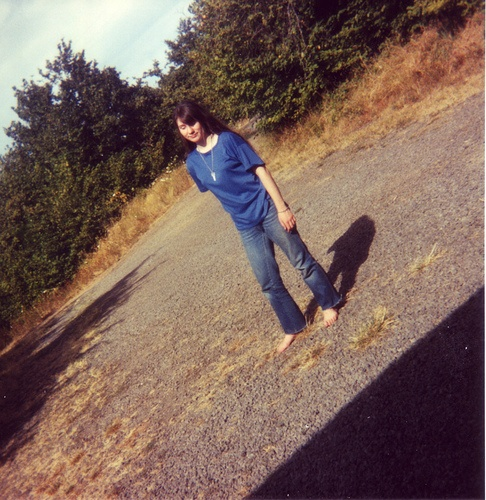

In [13]:
import PIL
img = PIL.Image.open(files[0])
print(f"Image Dims: {img.shape}")
img

**Create the BBOX parser**

In [14]:
# parser = parsers.VOCBBoxParser(annotations_dir=dataset_path/"odFridgeObjects/annotations", 
#                                images_dir=dataset_path/"odFridgeObjects/images")

In [15]:
# Get the class_map, a utility that maps from number IDs to classs names
class_map = icedata.voc.class_map()

parser = parsers.VOCBBoxParser(annotations_dir=dataset_path/"Annotations", 
                               images_dir=dataset_path/"JPEGImages", class_map=class_map)

In [16]:
# # Get the class_map, a utility that maps from number IDs to classs names
# class_map = icedata.coco.class_map()

# parser = icedata.coco.parser_bbox(annotations_filepath=dataset_path/"instances_train2014.json", 
#                                img_dir=dataset_path/"train2014", idmap=class_map)

In [17]:
# # Get the class_map, a utility that maps from number IDs to classs names
# # class_map = icedata.coco.class_map()
# parser = icedata.coco.parser_bbox(annotations_filepath=dataset_path/'train/_annotations.coco.json', img_dir=dataset_path/"train")

**Parse annotations to create records**

In [18]:
# Randomly split our data into train/valid
data_splitter = RandomSplitter([0.8, 0.2])

train_records, valid_records = parser.parse(data_splitter)
parser.class_map

  0%|          | 0/17125 [00:00<?, ?it/s]

INFO     - Autofixing records | icevision.parsers.parser:parse:122


  0%|          | 0/17125 [00:00<?, ?it/s]

<ClassMap: {0: 0, 'aeroplane': 1, 'bicycle': 2, 'bird': 3, 'boat': 4, 'bottle': 5, 'bus': 6, 'car': 7, 'cat': 8, 'chair': 9, 'cow': 10, 'diningtable': 11, 'dog': 12, 'horse': 13, 'motorbike': 14, 'person': 15, 'pottedplant': 16, 'sheep': 17, 'sofa': 18, 'train': 19, 'tvmonitor': 20}>

**Note:** The `background` class is not included in the final model.

**Select a multiple of 128 as the input resolution**

In [19]:
[128*i for i in range(1,6)]

[128, 256, 384, 512, 640]

In [20]:
image_size = 384

**Define Transforms**

In [21]:
train_tfms = tfms.A.Adapter([*tfms.A.aug_tfms(size=image_size, presize=512), tfms.A.Normalize()])
valid_tfms = tfms.A.Adapter([*tfms.A.resize_and_pad(image_size), tfms.A.Normalize()])

**Get normalization stats**

In [22]:
norm_args = inspect_default_args(tfms.A.Normalize)
norm_args

,Default Value
self,None
mean,"(0.485, 0.456, 0.406)"
std,"(0.229, 0.224, 0.225)"
max_pixel_value,255
always_apply,False
p,1


In [23]:
mean = norm_args['Default Value']['mean']
std = norm_args['Default Value']['std']
mean, std

((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))

**Define Datasets**

In [24]:
train_ds = Dataset(train_records, train_tfms)
valid_ds = Dataset(valid_records, valid_tfms)
train_ds, valid_ds

(<Dataset with 13700 items>, <Dataset with 3425 items>)

**Apply augmentations to a training sample**

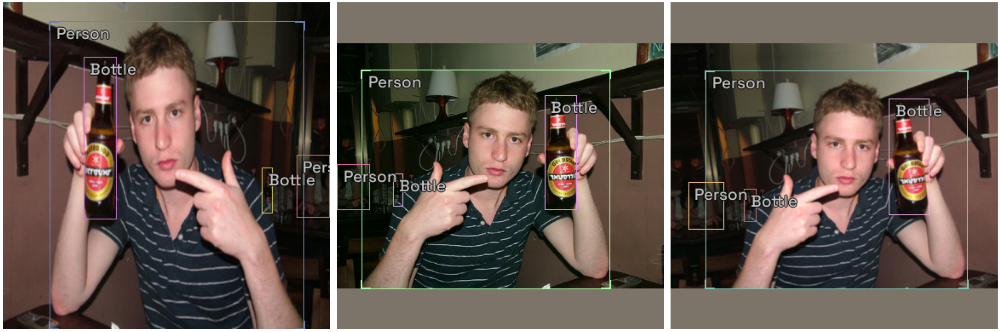

In [25]:
samples = [train_ds[0] for _ in range(3)]
show_samples(samples, ncols=3)

**Define model type**

In [28]:
model_type = models.ross.efficientdet

**Define backbone**

In [29]:
backbone = model_type.backbones.tf_lite0
pd.DataFrame.from_dict(backbone.__dict__, orient='index')

,0
model_name,tf_efficientdet_lite0


**Define batch size**

In [30]:
bs = 32

**Define DataLoaders**

In [31]:
train_dl = model_type.train_dl(train_ds, batch_size=bs, num_workers=8, shuffle=True)
valid_dl = model_type.valid_dl(valid_ds, batch_size=bs, num_workers=8, shuffle=False)

**Verify DataLoaders**

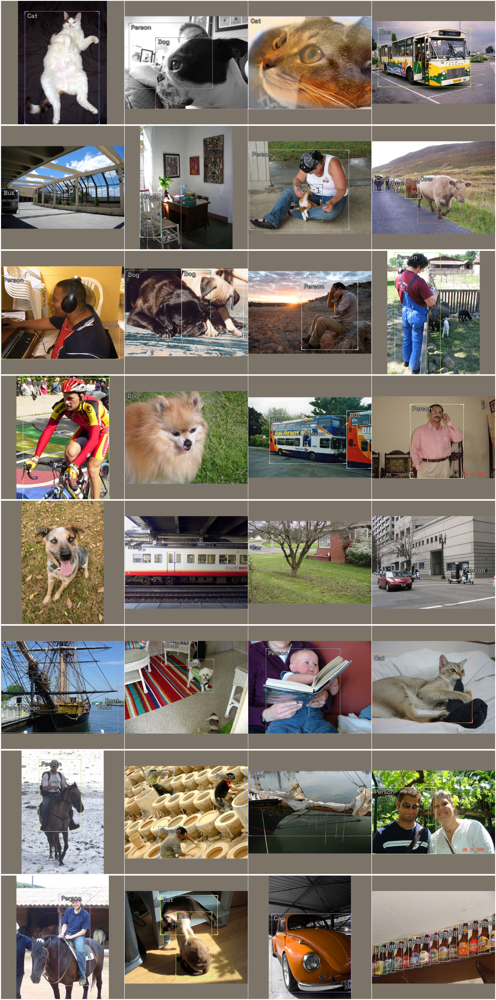

In [32]:
model_type.show_batch(first(valid_dl), ncols=4)

**Instantiate the model**

In [35]:
model = model_type.model(backbone=backbone(pretrained=True), num_classes=len(parser.class_map), img_size=image_size)

Downloading: "https://github.com/rwightman/efficientdet-pytorch/releases/download/v0.1/tf_efficientdet_lite0-f5f303a9.pth" to /home/innom-dt/.cache/torch/hub/checkpoints/tf_efficientdet_lite0-f5f303a9.pth


**Define metrics**

In [36]:
metrics = [COCOMetric(metric_type=COCOMetricType.bbox)]

**Define Learner object**

In [37]:
learn = model_type.fastai.learner(dls=[train_dl, valid_dl], model=model, metrics=metrics)

**Find learning rate**

SuggestedLRs(valley=0.00363078061491251)

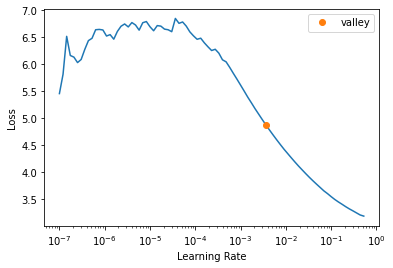

In [38]:
learn.lr_find()

**Define learning rate**

In [39]:
lr = 1e-3
# lr = 3e-4

**Define number of epochs**

In [40]:
epochs = 20

**Finetune model**

In [ ]:
learn.fine_tune(epochs, lr, freeze_epochs=1)

epoch,train_loss,valid_loss,COCOMetric,time
0,1.110834,1.032418,0.028423,04:10


/home/innom-dt/mambaforge/envs/icevision/lib/python3.8/site-packages/effdet/bench.py:45: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  indices_all = cls_topk_indices_all // num_classes


epoch,train_loss,valid_loss,COCOMetric,time
0,0.886228,0.818424,0.095221,04:40
1,0.764244,0.698665,0.178213,04:39
2,0.671666,0.612097,0.288981,04:31
3,0.621303,0.576299,0.344988,04:28
4,0.580655,0.548763,0.379041,04:29
5,0.564387,0.543599,0.393932,04:28
6,0.551503,0.514232,0.426246,04:19
7,0.531928,0.512084,0.426952,03:06
8,0.538904,0.516699,0.418572,02:53
9,0.524566,0.510414,0.423871,03:03


**Create an inference dataloader using the validation set**

In [42]:
infer_dl = model_type.infer_dl(valid_ds, batch_size=4, shuffle=False)

**Get model predictions**

  0%|          | 0/857 [00:00<?, ?it/s]

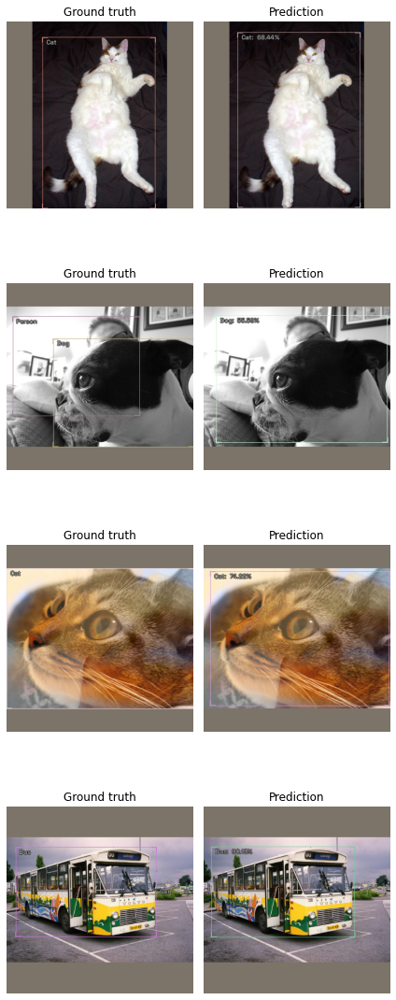

In [43]:
preds = model_type.predict_from_dl(model, infer_dl, keep_images=True)
show_preds(preds=preds[:4])

**Define method to convert a PIL Image to a Pytorch Tensor**

In [44]:
def img_to_tensor(img:PIL.Image, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    # Convert image to tensor
    img_tensor = torch.Tensor(np.array(img)).permute(2, 0, 1)
    # Scale pixels values from [0,255] to [0,1]
    scaled_tensor = img_tensor.float().div_(255)
    # Prepare normalization tensors
    mean_tensor = tensor(mean).view(1,1,-1).permute(2, 0, 1)
    std_tensor = tensor(std).view(1,1,-1).permute(2, 0, 1)
    # Normalize tensor    
    normalized_tensor = (scaled_tensor - mean_tensor) / std_tensor
    # Batch tensor
    return normalized_tensor.unsqueeze(dim=0)

**Select a test image**

In [45]:
test_file = files[0]
test_file.name

'2007_000027.jpg'

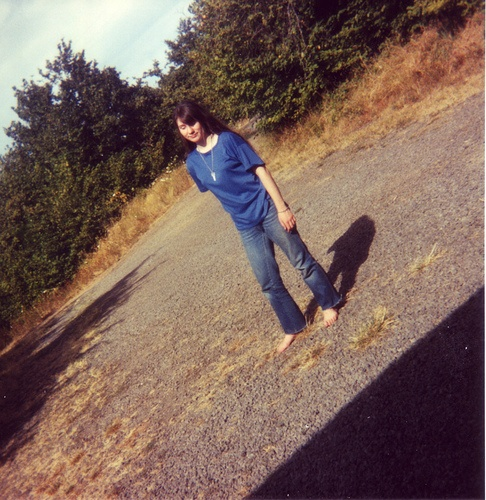

In [46]:
test_img = PIL.Image.open(test_file).convert('RGB')
test_img

In [47]:
# stride_val = 128
stride_val = 32

In [48]:
input_h = test_img.height - (test_img.height % stride_val)
input_w = test_img.width - (test_img.width % stride_val)
input_h, input_w

(480, 480)

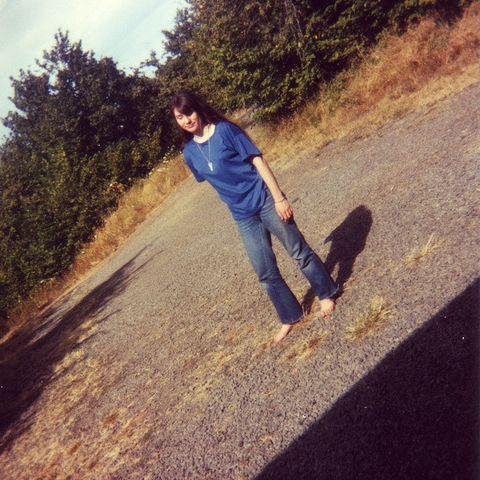

In [49]:
test_img = test_img.crop_pad((input_w, input_h))
# test_img = test_img.resize((input_w, input_h))
test_img

In [50]:
test_tensor = img_to_tensor(test_img, mean=mean, std=std)
test_tensor.shape

torch.Size([1, 3, 480, 480])

In [51]:
origin_forward = model.forward

In [ ]:
model.forward = model.forward_dummy

In [ ]:
model.

In [52]:
model_output = model.cpu()(test_tensor.cpu())

TypeError: forward() missing 1 required positional argument: 'target'

In [ ]:
for raw_out in model_output:
    for out in raw_out:
        print(out.shape)

In [ ]:
def forward_export(self, input_tensor):
    # Get raw model output
    model_output = self.forward_dummy(input_tensor.cpu())
    # Extract class scores
    cls_scores = model_output[0]
    # Extract bounding box predictions
    bbox_preds = model_output[1]
    # Extract objectness scores
    objectness = model_output[2]
    
    stride_8_cls = torch.sigmoid(cls_scores[0])
    stride_8_bbox = bbox_preds[0]
    stride_8_objectness = torch.sigmoid(objectness[0])
#     stride_8_cat = torch.cat((stride_8_cls, stride_8_bbox, stride_8_objectness), dim=1)
    stride_8_cat = torch.cat((stride_8_bbox, stride_8_objectness, stride_8_cls), dim=1)
    stride_8_flat = torch.flatten(stride_8_cat, start_dim=2)

    stride_16_cls = torch.sigmoid(cls_scores[1])
    stride_16_bbox = bbox_preds[1]
    stride_16_objectness = torch.sigmoid(objectness[1])
#     stride_16_cat = torch.cat((stride_16_cls, stride_16_bbox, stride_16_objectness), dim=1)
    stride_16_cat = torch.cat((stride_16_bbox, stride_16_objectness, stride_16_cls), dim=1)
    stride_16_flat = torch.flatten(stride_16_cat, start_dim=2)

    stride_32_cls = torch.sigmoid(cls_scores[2])
    stride_32_bbox = bbox_preds[2]
    stride_32_objectness = torch.sigmoid(objectness[2])
#     stride_32_cat = torch.cat((stride_32_cls, stride_32_bbox, stride_32_objectness), dim=1)
    stride_32_cat = torch.cat((stride_32_bbox, stride_32_objectness, stride_32_cls), dim=1)
    stride_32_flat = torch.flatten(stride_32_cat, start_dim=2)

    full_cat = torch.cat((stride_8_flat, stride_16_flat, stride_32_flat), dim=2)

    return full_cat.permute(0, 2, 1)

In [ ]:
model.forward_export = forward_export.__get__(model)

In [ ]:
model.forward_export(test_tensor).shape

In [ ]:
model.forward = model.forward_export

In [ ]:
model(test_tensor).shape

In [ ]:
parser.class_map

In [ ]:
cls_out_channels = parser.class_map.num_classes - 1
cls_out_channels

In [ ]:
onnx_file_name = f"{dataset_path.name}-{type(learn.model.model).__name__}.onnx"
onnx_file_name

In [ ]:
torch.onnx.export(model,
                  test_tensor,
                  onnx_file_name,
                  export_params=True,
                  opset_version=11,
                  do_constant_folding=True,
                  input_names = ['input'],
                  output_names = ['output'],
                  dynamic_axes={'input': {2 : 'height', 3 : 'width'}}
                 )

In [ ]:
from IPython.display import Markdown, display

In [ ]:
from openvino.runtime import Core

In [ ]:
output_dir = Path('./')
output_dir

In [ ]:
ir_path = Path(f"{onnx_file_name.split('.')[0]}.xml")
ir_path

In [ ]:
# Construct the command for Model Optimizer
mo_command = f"""mo
                 --input_model "{onnx_file_name}"
                 --input_shape "[1,3, {image_size}, {image_size}]"
                 --mean_values="{mean}"
                 --scale_values="{std}"
                 --data_type FP16
                 --output_dir "{output_dir}"
                 """
mo_command = " ".join(mo_command.split())
print("Model Optimizer command to convert the ONNX model to OpenVINO:")
display(Markdown(f"`{mo_command}`"))

In [ ]:
if not ir_path.exists():
    print("Exporting ONNX model to IR... This may take a few minutes.")
    mo_result = %sx $mo_command
    print("\n".join(mo_result))
else:
    print(f"IR model {ir_path} already exists.")

In [ ]:
test_img

In [ ]:
# Convert image to tensor
img_tensor = torch.Tensor(np.array(test_img)).permute(2, 0, 1)
# Scale pixels values from [0,255] to [0,1]
scaled_tensor = img_tensor.float().div_(255)

In [ ]:
input_image = scaled_tensor.unsqueeze(dim=0)
input_image.shape

In [ ]:
ir_path

In [ ]:
# Load the network in Inference Engine
ie = Core()
model_ir = ie.read_model(model=ir_path)
model_ir.reshape(input_image.shape)
compiled_model_ir = ie.compile_model(model=model_ir, device_name="CPU")

# Get input and output layers
input_layer_ir = next(iter(compiled_model_ir.inputs))
output_layer_ir = next(iter(compiled_model_ir.outputs))

# Run inference on the input image
res_ir = compiled_model_ir([input_image])[output_layer_ir]

**Benchmark OpenVINO IR CPU inference speed**

In [ ]:
%%timeit
compiled_model_ir([input_image])[output_layer_ir]

In [ ]:
compiled_model_ir([input_image])[output_layer_ir].shape

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

**Get list of labels without the background class**

In [ ]:
labels = parser.class_map.get_classes()[1:]
labels

**Import library for generating color palette**

In [ ]:
from distinctipy import distinctipy

**Generate a visually distinct color for each label**

In [ ]:
colors = distinctipy.get_colors(len(labels))

**Display the generated color palette**

In [ ]:
distinctipy.color_swatch(colors)

**Set precision for color values**

In [ ]:
precision = 5

**Round color values to specified precision**

In [ ]:
colors = [list(np.random.random(size=3).round(precision)) for label in labels]
colors

**Create JSON color map**

In [ ]:
color_map = {'items': list()}
color_map['items'] = [{'label': label, 'color': color} for label, color in zip(labels, colors)]
color_map

In [ ]:
dataset_path.name

**Export color map**

In [ ]:
import json

color_map_file_name = f"{dataset_path.name}-colormap.json"

with open(color_map_file_name, "w") as write_file:
    json.dump(color_map, write_file)
    
color_map_file_name

In [ ]:
labels_cpp_file_name = f'{dataset_path.name}-labels-cpp.txt'
colormap_cpp_file_name = f'{dataset_path.name}-colormap-cpp.txt'

with open(labels_cpp_file_name, "w") as write_file:
    write_file.write(str(labels).replace("'", '"').replace("[", '{').replace("]", '}'))

with open(colormap_cpp_file_name, "w") as write_file:
    write_file.write(str(colors).replace("'", '"').replace("[", '{').replace("]", '}'))